<a href="https://colab.research.google.com/github/chulminkim86/2019-1.-ManagementAndDatabase/blob/master/PublicBike.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 서울시 공공 자전거 이용 행태 분석하기

## 1. Loading Data

### 1) 필요한 라이브러리들을 호출

In [ ]:
#필요 라이브러리 호출
import pandas as pd
import seaborn as sns
%matplotlib inline
import folium
import json

In [ ]:
#그래프에 한글 표시하기
import matplotlib as mpl
import matplotlib.pyplot as plt
 
%config InlineBackend.figure_format = 'retina'
 
!apt -qq -y install fonts-nanum
 
import matplotlib.font_manager as fm
fontpath = '/usr/share/fonts/truetype/nanum/NanumBarunGothic.ttf'
font = fm.FontProperties(fname=fontpath, size=9)
plt.rc('font', family='NanumBarunGothic') 
mpl.font_manager._rebuild()

### 2) CSV파일을 호출하고 각 변수에 값 할당

In [ ]:
stations_raw = pd.read_csv("stations_raw.csv")
stations_raw.head()

,대여소번호,대여소명,자치구,상세주소,위도,경도,설치시기,LCD거치대수,QR거치대수,운영방식
0,1695.0,월계미륭아파트 정문,노원구,노원구 월계동 14,37.623417,127.066933,2020-06-17,NaN,10.0,QR
1,2301.0,현대고등학교 건너편,강남구,서울특별시 강남구 압구정로 134,37.524071,127.021790,2017-06-13,10.0,NaN,LCD
2,2302.0,교보타워 버스정류장(신논현역 3번출구 후면),강남구,서울특별시 강남구 봉은사로 지하 102,37.505581,127.024277,2017-06-13,10.0,NaN,LCD
3,2303.0,논현역 7번출구,강남구,서울특별시 강남구 학동로 지하 102,37.511517,127.021477,2017-06-13,15.0,NaN,LCD
4,2304.0,신영 ROYAL PALACE 앞,강남구,서울특별시 강남구 언주로 626,37.512527,127.035835,2017-06-13,10.0,NaN,LCD


In [ ]:
#자전거 정류소 정보 확인
stations_raw.info()
stations_raw.tail()
#마지막 행이 모두 결측치로 수집되었음을 확인

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2084 entries, 0 to 2083
Data columns (total 10 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   대여소번호    2083 non-null   float64
 1   대여소명     2083 non-null   object 
 2   자치구      2083 non-null   object 
 3   상세주소     2083 non-null   object 
 4   위도       2083 non-null   float64
 5   경도       2083 non-null   float64
 6   설치시기     2083 non-null   object 
 7   LCD거치대수  1531 non-null   float64
 8   QR거치대수   552 non-null    float64
 9   운영방식     2083 non-null   object 
dtypes: float64(5), object(5)
memory usage: 122.2+ KB


,대여소번호,대여소명,자치구,상세주소,위도,경도,설치시기,LCD거치대수,QR거치대수,운영방식
2079,1573.0,현대성우아파트 옆,강북구,미아동 670-33,37.616665,127.022110,2020-05-05,NaN,10.0,QR
2080,1268.0,몽촌토성역 1번출구 옆,송파구,서울특별시 송파구 방이동 88-21,37.517288,127.114197,2020-06-25,NaN,15.0,QR
2081,1267.0,올림픽공원 남2문 앞,송파구,서울특별시 송파구 올림픽로 424,37.514240,127.123070,2020-06-25,NaN,15.0,QR
2082,583.0,청계천 생태교실 앞,성동구,서울특별시 성동구 마장로39길 51,37.567970,127.046890,2020-06-30,NaN,5.0,QR
2083,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
#결측치로 가득한 마지막 행 삭제
stations_raw.drop(stations_raw.index[2083], inplace=True)

In [ ]:
#대여소번호에 중복이 있는지 확인 
stations_raw[stations_raw.duplicated("대여소번호", keep=False)]
#LCD와 QR거치대가 둘 다 있는 No. 583 대여소가 두개 입력되어 있음

,대여소번호,대여소명,자치구,상세주소,위도,경도,설치시기,LCD거치대수,QR거치대수,운영방식
1276,583.0,청계천 생태교실 앞,성동구,서울특별시 성동구 마장로39길 51,37.56797,127.04689,2016-07-06,20.0,NaN,LCD
2082,583.0,청계천 생태교실 앞,성동구,서울특별시 성동구 마장로39길 51,37.56797,127.04689,2020-06-30,NaN,5.0,QR


In [ ]:
#자전거 정류소 데이터 정리를 위한 열 이름 가져오기
stations = stations_raw[["대여소번호", "대여소명", "자치구", "상세주소", "위도", "경도", "설치시기", "LCD거치대수", "QR거치대수", "운영방식"]]

#중복요소를 제거
stations_geo = stations.drop_duplicates("대여소번호")[["대여소번호", "위도", "경도"]].set_index("대여소번호")

In [ ]:
#정돈된 자전거 대여소 데이터 정보 확인
display(stations.head())
display(stations_geo.head())

,대여소번호,대여소명,자치구,상세주소,위도,경도,설치시기,LCD거치대수,QR거치대수,운영방식
0,1695.0,월계미륭아파트 정문,노원구,노원구 월계동 14,37.623417,127.066933,2020-06-17,NaN,10.0,QR
1,2301.0,현대고등학교 건너편,강남구,서울특별시 강남구 압구정로 134,37.524071,127.021790,2017-06-13,10.0,NaN,LCD
2,2302.0,교보타워 버스정류장(신논현역 3번출구 후면),강남구,서울특별시 강남구 봉은사로 지하 102,37.505581,127.024277,2017-06-13,10.0,NaN,LCD
3,2303.0,논현역 7번출구,강남구,서울특별시 강남구 학동로 지하 102,37.511517,127.021477,2017-06-13,15.0,NaN,LCD
4,2304.0,신영 ROYAL PALACE 앞,강남구,서울특별시 강남구 언주로 626,37.512527,127.035835,2017-06-13,10.0,NaN,LCD


,위도,경도
대여소번호,,
1695.0,37.623417,127.066933
2301.0,37.524071,127.021790
2302.0,37.505581,127.024277
2303.0,37.511517,127.021477
2304.0,37.512527,127.035835


In [ ]:
#자전거 대여 정보 가져오기
rent = pd.read_csv("BikeRent.csv")
rent.head()

,자전거번호,대여일시,대여 대여소번호,대여 대여소명,대여거치대,반납일시,반납대여소번호,반납대여소명,반납거치대,이용시간,이용거리
0,SPB-33273,2020-06-01 0:03,1050,둔촌역 3번 출입구,0,2020-06-01 0:05,1078,둔촌사거리,0,3,0.0
1,SPB-30703,2020-06-01 0:00,1132,등촌역 7번출구,0,2020-06-01 0:06,1169,염창역 1번 출구,0,6,0.0
2,SPB-31969,2020-06-01 0:02,1306,한성대입구역2번출구,0,2020-06-01 0:06,388,동성중학교 앞,0,4,0.0
3,SPB-19763,2020-06-01 0:00,956,응암시장교차로,8,2020-06-01 0:08,939,은평구청 교차로,6,7,1340.0
4,SPB-32949,2020-06-01 0:04,709,신정3동 현장민원실 앞,0,2020-06-01 0:08,712,강월초교입구 사거리,0,5,0.0


In [ ]:
#자전거 번호별 대여 횟수
grouped_rent = rent.groupby("자전거번호")
grouped_rent.size()

자전거번호
SPB-00025    90
SPB-00036     3
SPB-00050    51
SPB-00071     8
SPB-00102    47
             ..
SPB-34496    16
SPB-34497    19
SPB-34498    21
SPB-34499    20
SPB-34500    20
Length: 12691, dtype: int64

In [ ]:
#자전거 번호별 이용시간과 이용거리 총합 확인하기
grouped_rent[["이용시간", "이용거리"]].sum()
grouped_rent[["이용시간", "이용거리"]].mean()
grouped_rent[["이용시간", "이용거리"]].max()

,이용시간,이용거리
자전거번호,,
SPB-00025,111,45070.0
SPB-00036,101,17890.0
SPB-00050,102,33750.0
SPB-00071,33,6300.0
SPB-00102,123,0.0
...,...,...
SPB-34496,90,0.0
SPB-34497,87,0.0
SPB-34498,153,0.0


In [ ]:
#개별 자전거 번호별 정보를 확인하고 싶은 경우 
grouped_rent.get_group("SPB-32858")

,자전거번호,대여일시,대여 대여소번호,대여 대여소명,대여거치대,반납일시,반납대여소번호,반납대여소명,반납거치대,이용시간,이용거리
322,SPB-32858,2020-06-01 0:38,2066,양문교회 앞,0,2020-06-01 0:56,2112,서울대입구역 마에스트로,0,18,0.0
396,SPB-32858,2020-06-01 1:00,2112,서울대입구역 마에스트로,0,2020-06-01 1:02,2160,관악구 보건소,0,2,0.0
795,SPB-32858,2020-06-01 1:11,2160,관악구 보건소,0,2020-06-01 1:39,2107,도림천 신화교,0,28,0.0
3759,SPB-32858,2020-06-01 6:58,2107,도림천 신화교,0,2020-06-01 7:14,2056,동작구민 체육센터,0,16,0.0
4124,SPB-32858,2020-06-01 7:15,2056,동작구민 체육센터,0,2020-06-01 7:27,2063,대방역 4번출구,0,12,0.0
...,...,...,...,...,...,...,...,...,...,...,...
1025112,SPB-32858,2020-06-16 18:16,2651,경찰병원역 3번출구 앞,0,2020-06-16 18:34,1207,마천CU우방점 앞,0,18,0.0
1026471,SPB-32858,2020-06-16 18:41,1207,마천CU우방점 앞,0,2020-06-16 18:46,1280,송파파크데일 2단지입구 앞 주차장,0,5,0.0
1031225,SPB-32858,2020-06-16 19:11,1280,송파파크데일 2단지입구 앞 주차장,0,2020-06-16 19:30,1215,올림픽공원역 1번출구 앞,0,18,0.0
1040123,SPB-32858,2020-06-16 19:30,1215,올림픽공원역 1번출구 앞,0,2020-06-16 21:16,2622,올림픽공원역 3번출구,0,105,0.0


## 3. 데이터 시각화하기

In [ ]:
print("총 대여소 수:", len(stations))
print("총 거치대 수:", stations[["LCD거치대수", "QR거치대수"]].sum().sum())

총 대여소 수: 2083
총 거치대 수: 27115.0


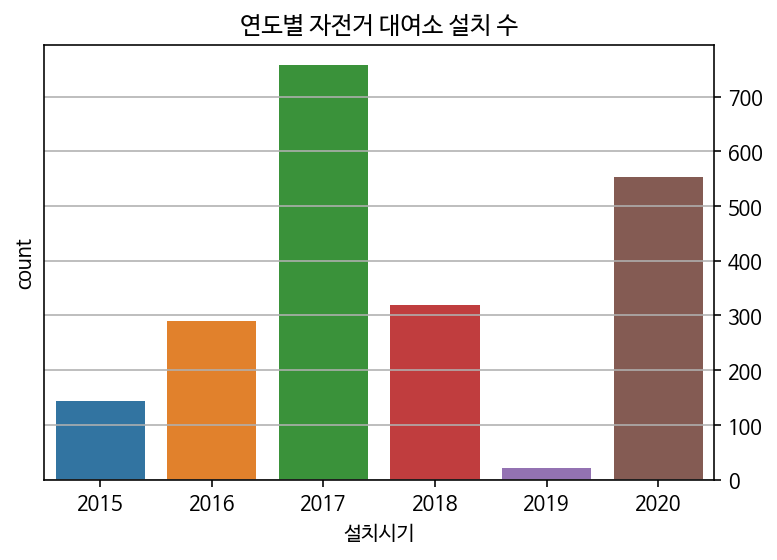

In [ ]:
#연도별 자전거 대여소 설치 수 

fig, ax = plt.subplots()

stations["설치시기"] = pd.to_datetime(stations["설치시기"])
sns.countplot(stations["설치시기"].dt.year, ax=ax)
ax.grid(axis="y")
ax.set_title("연도별 자전거 대여소 설치 수")
ax.yaxis.tick_right()

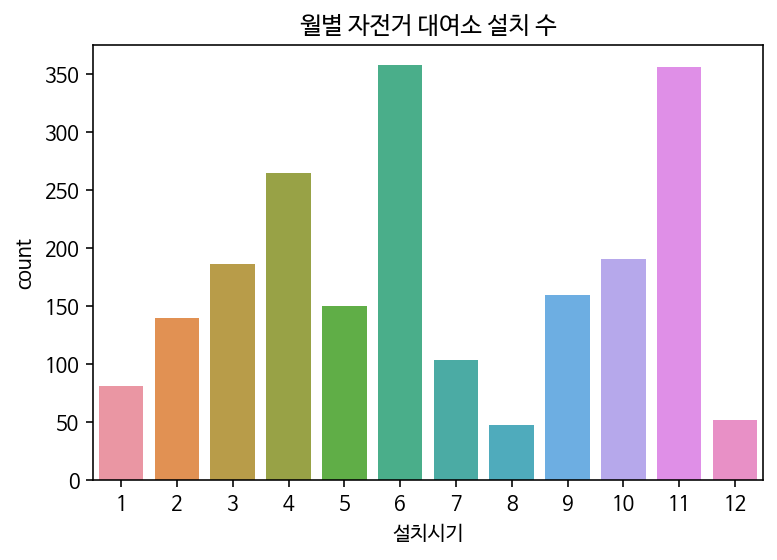

In [ ]:
#월별 자전거 대여소 설치 수 
fig, ax = plt.subplots()
sns.countplot(stations["설치시기"].dt.month, ax=ax)
ax.set_title("월별 자전거 대여소 설치 수")
pass

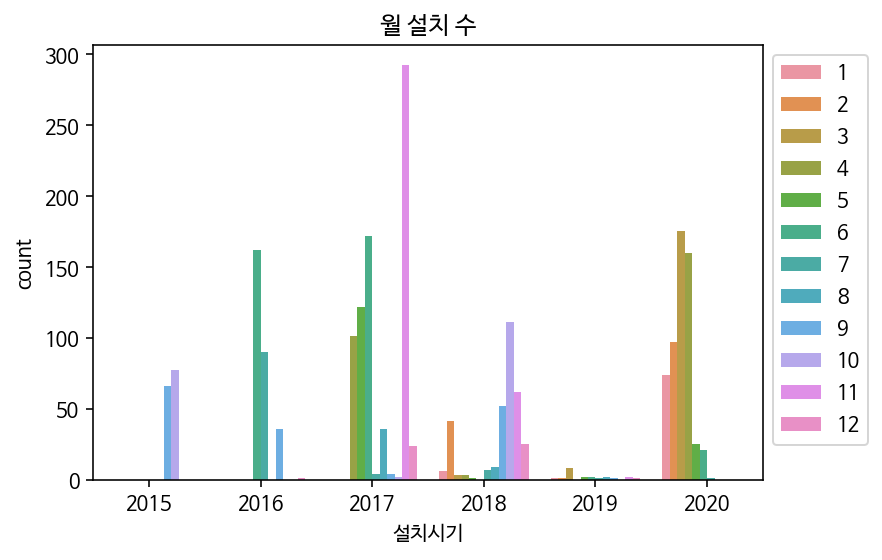

In [ ]:
#연간 월별 자전거 설치 시기 

fig, ax=plt.subplots()
sns.countplot(stations["설치시기"].dt.year, hue=stations["설치시기"].dt.month, ax=ax)
ax.set_title("월 설치 수")
ax.legend(bbox_to_anchor=(1,1))
pass

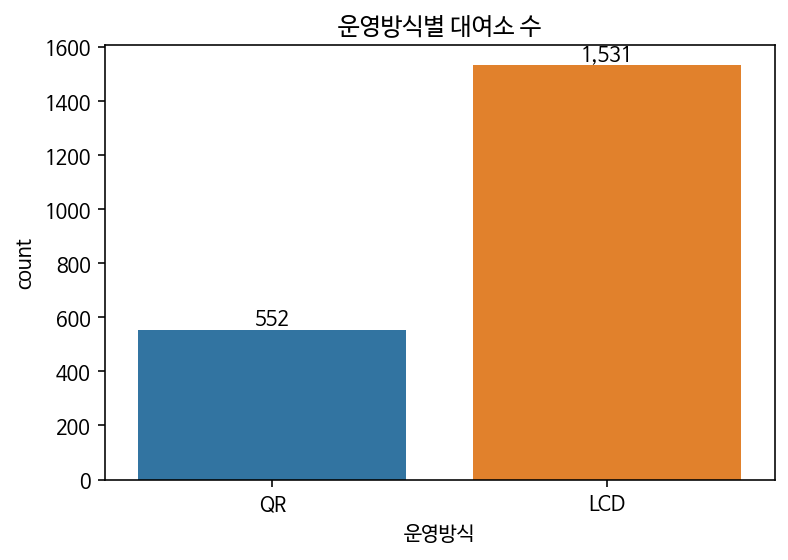

In [ ]:
#운영방식별 대여소 수 

fig, ax = plt.subplots()
sns.countplot(stations["운영방식"], ax=ax)

#데이터 레이블 추가하기
for patch in ax.patches:
    xs = patch.get_bbox().get_points()[:,0] #막대에 숫자표기
    y = patch.get_bbox().get_points()[1,1]
    ax.annotate(f"{int(y):,d}", (xs.mean(), y), ha="center", va="bottom")

ax.set_title("운영방식별 대여소 수")
pass

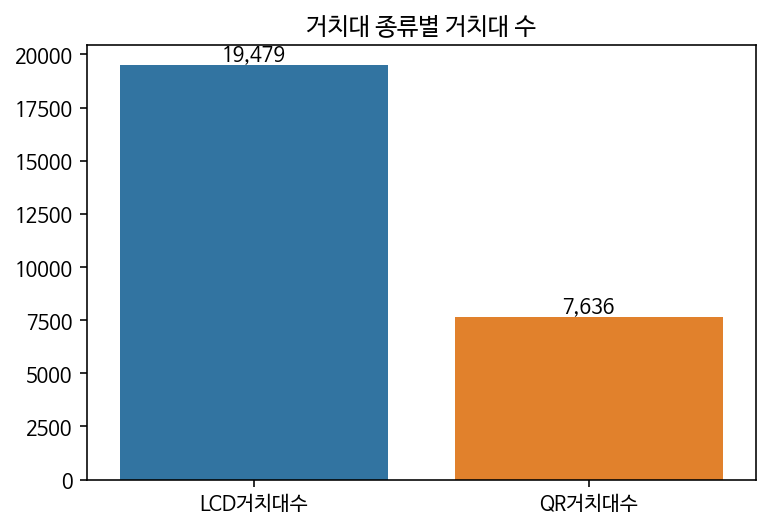

In [ ]:
#거치대 종류별 거치대 수 

n_racks = stations[["LCD거치대수", "QR거치대수"]].sum()

fig, ax = plt.subplots()
sns.barplot(n_racks.index, n_racks, ax=ax)

for patch in ax.patches:
    xs = patch.get_bbox().get_points()[:,0] #막대에 숫자표기
    y = patch.get_bbox().get_points()[1,1]
    ax.annotate(f"{int(y):,d}", (xs.mean(), y), ha="center", va="bottom")

ax.set_title("거치대 종류별 거치대 수")
pass

In [ ]:
#서울시 내 자치구 개수 파악
gu_sorted = sorted(stations["자치구"].unique())
gu_sorted

['강남구',
 '강동구',
 '강북구',
 '강서구',
 '관악구',
 '광진구',
 '구로구',
 '금천구',
 '노원구',
 '도봉구',
 '동대문구',
 '동작구',
 '마포구',
 '서대문구',
 '서초구',
 '성동구',
 '성북구',
 '송파구',
 '양천구',
 '영등포구',
 '용산구',
 '은평구',
 '종로구',
 '중구',
 '중랑구']

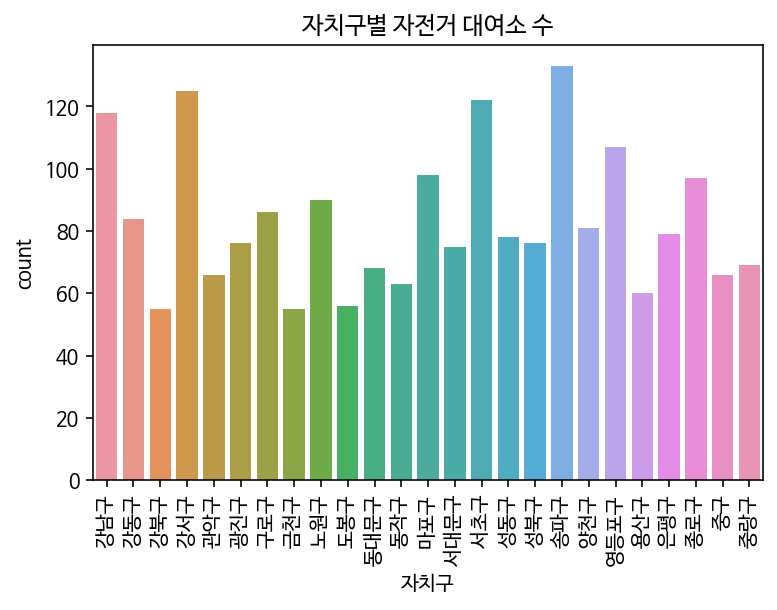

In [ ]:
#자치구별 자전거 대여소 수 
fig, ax = plt.subplots()
stations["자치구"] = stations["자치구"].astype(str)
sns.countplot(stations["자치구"], order=gu_sorted, ax=ax)
ax.tick_params(axis="x", labelrotation=90)
ax.set_title("자치구별 자전거 대여소 수")
pass

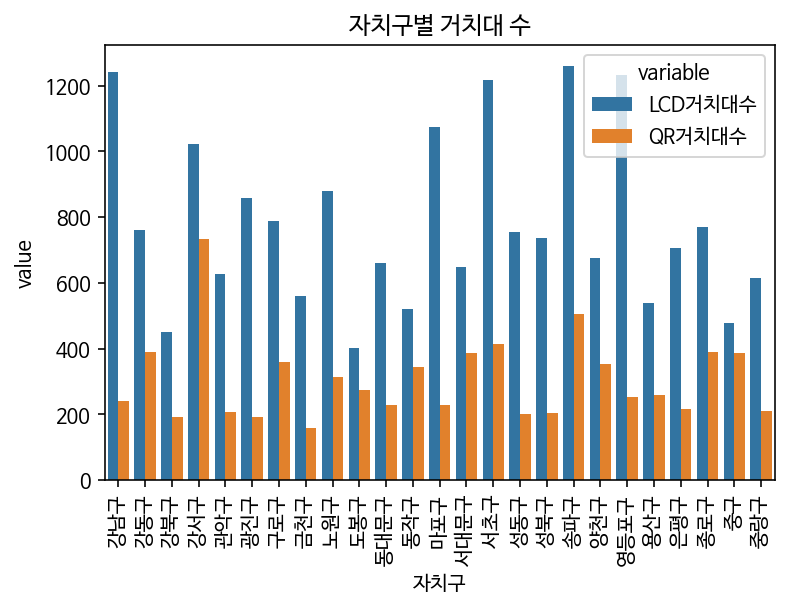

In [ ]:
#자치구별 거치대 수 
n_racks_by_gu = stations[["자치구", "LCD거치대수", "QR거치대수"]].groupby("자치구").sum()

fig, ax = plt.subplots()
sns.barplot(
    x="자치구",
    y="value",
    hue="variable",
    data=n_racks_by_gu.reset_index().melt(id_vars="자치구"),
    order=gu_sorted,
    ax=ax,
)

ax.tick_params(axis="x", labelrotation=90)
ax.set_title("자치구별 거치대 수")
pass

In [ ]:
#자전거 관련 정보 지도에 표시하기

LOCATION_SEOUL = [37.56, 127.00]

m=folium.Map(location=LOCATION_SEOUL, zoom_start=11)
m

In [ ]:
#모든 대여소를 지도에 표시하기
m = folium.Map(location=LOCATION_SEOUL, zoom_start=11)
for row in stations.itertuples():
    folium.CircleMarker([row.위도, row.경도], radius=2, color="blue").add_to(m)
m

In [ ]:
with open("skorea-municipalities-2018-geo.json") as f:
    municipalities_geo = json.load(f)

In [ ]:
#자치구별 대여소 구역별 밀도 확인하기 

count_by_gu = stations["자치구"].value_counts()

m = folium.Map(location=LOCATION_SEOUL, zoom_start=11)
folium.Choropleth(
    geo_data=municipalities_geo,
    data=count_by_gu,
    fill_color="PuRd",
    key_on="feature.properties.name",
).add_to(m)
m

In [ ]:
#특정 자전거 대여 장소 이력
target_bike = "SPB-32858"
sample = rent.query("자전거번호 == @target_bike").sort_values("대여일시")
sample.head()

,자전거번호,대여일시,대여 대여소번호,대여 대여소명,대여거치대,반납일시,반납대여소번호,반납대여소명,반납거치대,이용시간,이용거리
322,SPB-32858,2020-06-01 0:38,2066,양문교회 앞,0,2020-06-01 0:56,2112,서울대입구역 마에스트로,0,18,0.0
25079,SPB-32858,2020-06-01 15:04,222,시범아파트버스정류장 옆,0,2020-06-01 15:23,258,신길역3번출구,0,19,0.0
26057,SPB-32858,2020-06-01 15:36,258,신길역3번출구,0,2020-06-01 15:42,274,영등포역지하쇼핑센타 5번출구,0,6,0.0
29696,SPB-32858,2020-06-01 15:54,274,영등포역지하쇼핑센타 5번출구,0,2020-06-01 16:45,207,여의나루역 1번출구 앞,0,51,0.0
31421,SPB-32858,2020-06-01 16:49,207,여의나루역 1번출구 앞,0,2020-06-01 17:10,274,영등포역지하쇼핑센타 5번출구,0,21,0.0


In [ ]:
target_bike = "SPB-30703"
sample = rent[rent["대여일시"].isin(pd.date_range("2020-06-01", "2020-06-30"))]
sample = sample.query("자전거번호 == @target_bike").sort_values("대여일시")
sample

,자전거번호,대여일시,대여 대여소번호,대여 대여소명,대여거치대,반납일시,반납대여소번호,반납대여소명,반납거치대,이용시간,이용거리


In [ ]:
borrowing = stations_geo.loc[sample["대여 대여소번호"]]
borrowing.info()

<class 'pandas.core.frame.DataFrame'>
Float64Index: 0 entries
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   위도      0 non-null      float64
 1   경도      0 non-null      float64
dtypes: float64(2)
memory usage: 0.0 bytes


In [ ]:
borrowing = borrowing.values.tolist()

In [ ]:
borrowing

[]

In [ ]:
m = folium.Map(location=LOCATION_SEOUL, zoom_start=11)

folium.Marker(
    borrowing[0],
    popup = sample.iloc[0]["대여 대여소명"],
    icon=folium.Icon(color="green", icon="star"),
).add_to(m)

for row in stations.itertuples():
    folium.CircleMarker([row.위도, row.경도], radius=2, color="blue").add_to(m)
    
folium.PolyLine(borrowing, color="red").add_to(m)

folium.Marker(
    borrowing[-1],
    popup=sample.iloc[-1]["대여 대여소명"],
    icon=folium.Icon(color="red", icon="star"),
    ).add_to(m)

m

IndexError: list index out of range